In [1]:
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
from scarches.models.scpoli import scPoli

sc.settings.set_figure_params(dpi=300, frameon=False)
%config InlineBackend.figure_formats = ['pdf']


%load_ext autoreload
%autoreload 2

INFO:pytorch_lightning.utilities.seed:Global seed set to 0
/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)
 captum (see https://github.com/pytorch/captum).


In [2]:
adata = sc.read('/lustre/groups/ml01/workspace/hediyehzadeh.s/shared_data/multigrate_multimil/data/schulte-schrepping_2020_rna.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 222003 × 35496
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nReads_RNA', 'nReads_ALL', 'percent.mito', 'percent.hb', 'donor', 'onset_of_symptoms', 'days_after_onset', 'sampleID', 'origID', 'date_of_sampling', 'DaysAfterSample0', 'experiment', 'PoolID', 'sampletag', 'hash.ID', 'platform', 'purification', 'cells', 'age', 'sex', 'group_per_sample', 'who_per_sample', 'disease_stage', 'outcome', 'comorbidities', 'COVID.19.related_medication_and_anti.microbials', 'RNA_snn_res.0.4', 'cluster_labels_res.0.4', 'new.order', 'id.celltype', 'hpca.labels', 'blueprint.labels', 'monaco.labels', 'immune.labels', 'dmap.labels', 'hemato.labels', 'cohort', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'demultID', 'cartridge', 'diagnosis', 'oxygen', 'primary_complaint', 'RNA_snn_res.0.8', 'cluster_labels_res.0.8', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'rna.snn_res.0.8', 'seurat

In [4]:
fred_full_meta = pd.read_csv('/lustre/groups/ml01/workspace/hediyehzadeh.s/shared_data/multigrate_multimil/notebooks/covid19_datasets_metadata_fredhutch.csv', index_col = 0)

datasetkey = 'schulte-schrepping_2020'
fred_meta = fred_full_meta[fred_full_meta.dataset == datasetkey]

/tmp/ipykernel_168950/3649966991.py:1: DtypeWarning: Columns (4,5,7,8,11) have mixed types. Specify dtype option on import or set low_memory=False.
  fred_full_meta = pd.read_csv('/lustre/groups/ml01/workspace/hediyehzadeh.s/shared_data/multigrate_multimil/notebooks/covid19_datasets_metadata_fredhutch.csv', index_col = 0)


In [5]:
fred_meta = fred_meta[['tissue','sample_type', 'patient', 'sample', 'sex','age','disease_status','disease_severity', 'days_since_symptom_onset']]

In [6]:
import re
# [Whole_blood|PBMC|CD45-sorted frozen PBMC]
fred_meta['sample'] = np.array([re.sub('(.*)_PBMC', '\\1', x) for x in fred_meta['sample']])
fred_meta['sample'] = np.array([re.sub('(.*)_Whole_blood', '\\1', x) for x in fred_meta['sample']])
fred_meta['sample'] = np.array([re.sub('(.*)_CD45-sorted frozen PBMC', '\\1', x) for x in fred_meta['sample']])

In [7]:
fred_meta.index = fred_meta['sample']
fred_meta.drop_duplicates(subset = ['sample'], inplace=True)
sample_annot = fred_meta.loc[adata.obs.sampleID]
sample_annot.index = adata.obs_names
adata.obs = pd.concat((adata.obs, sample_annot), axis = 1)

In [8]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=4000,
    batch_key = 'cohort', # previous choices: 'cohort', 'sample_type'
    subset=True,
)

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)


In [9]:
condition_keys = ['experiment', 'sampleID']
cell_type_key = ['predicted.celltype.l2'] # to challenge integration by different covariates

In [10]:
adata.X = adata.X.astype('float32')

In [11]:
adata

AnnData object with n_obs × n_vars = 222003 × 4000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nReads_RNA', 'nReads_ALL', 'percent.mito', 'percent.hb', 'donor', 'onset_of_symptoms', 'days_after_onset', 'sampleID', 'origID', 'date_of_sampling', 'DaysAfterSample0', 'experiment', 'PoolID', 'sampletag', 'hash.ID', 'platform', 'purification', 'cells', 'age', 'sex', 'group_per_sample', 'who_per_sample', 'disease_stage', 'outcome', 'comorbidities', 'COVID.19.related_medication_and_anti.microbials', 'RNA_snn_res.0.4', 'cluster_labels_res.0.4', 'new.order', 'id.celltype', 'hpca.labels', 'blueprint.labels', 'monaco.labels', 'immune.labels', 'dmap.labels', 'hemato.labels', 'cohort', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'demultID', 'cartridge', 'diagnosis', 'oxygen', 'primary_complaint', 'RNA_snn_res.0.8', 'cluster_labels_res.0.8', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'rna.snn_res.0.8', 'seurat_

In [12]:
#sc.pp.subsample(adata, n_obs=25000)

In [ ]:
scpoli_model = scPoli.load('schulte_hierarchical_exp_sample_final', adata=adata)

In [24]:
print('Initialize network')
scpoli_model = scPoli(
    adata=adata,
    condition_keys=condition_keys,
    cell_type_keys=cell_type_key,
    hidden_layer_sizes=[100],
    latent_dim=25,
    embedding_dims=[5, 10],
    recon_loss = 'mse',
    inject_condition=['encoder', 'decoder']
)


PARAMS = {                         #DATA USED FOR THE EXPERIMENT
    'EARLY_STOPPING_KWARGS': {                         #KWARGS FOR EARLY STOPPING
        "early_stopping_metric": "val_prototype_loss",  ####value used for early stopping
        "mode": "min",                                 ####choose if look for min or max
        "threshold": 0,
        "patience": 20,
        "reduce_lr": True,
        "lr_patience": 13,
        "lr_factor": 0.1,
    },
    'LABELED_LOSS_METRIC': 'dist',           
    'UNLABELED_LOSS_METRIC': 'dist',
    'LATENT_DIM': 50,
    'ALPHA_EPOCH_ANNEAL': 1e3,
    'CLUSTERING_RES': 2,
    'HIDDEN_LAYERS': 4,
    'ETA': 1,
}

Initialize network
Embedding dictionary:
 	Num conditions: [16, 99]
 	Embedding dim: [5, 10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 100 15
	Mean/Var Layer in/out: 100 10
Decoder Architecture:
	First Layer in, out and cond:  10 100 15
	Output Layer in/out:  100 4000 



In [18]:
scpoli_model.train(
    n_epochs=25,
    pretraining_epochs=20,
    early_stopping_kwargs=PARAMS['EARLY_STOPPING_KWARGS'],
    alpha_epoch_anneal=1e3,
    eta=1,
    weight_decay=0,
    use_stratified_sampling=False,
)

 |████████████████████| 100.0%  - val_loss: 176.3161534277 - val_cvae_loss: 173.4126601822 - val_prototype_loss: 2.9034930152 - val_labeled_loss: 2.9034930152


In [ ]:
adata_emb = scpoli_model.get_conditional_embeddings()['sampleID']
adata_emb.obs = adata.obs.groupby('sampleID').first().reindex(adata_emb.obs_names)
sc.pp.pca(adata_emb)
adata_emb.obs['disease_status'] = adata_emb.obs['disease_status'].astype(str)
adata_emb.write('schulte_final_sample_embedding.h5ad')
sc.pl.pca(adata_emb, color='disease_status', size=500)
sc.pl.pca(adata_emb, color='disease_status', components='2,3', size=500)
sc.pl.pca(adata_emb, color='cohort', size=500)
sc.pl.pca(adata_emb, color='experiment', size=500)

In [ ]:
adata_emb = scpoli_model.get_conditional_embeddings()['experiment']
adata_emb.obs = adata.obs.groupby('experiment').first().reindex(adata_emb.obs_names)
adata_emb.obs = adata_emb.obs.reset_index()
sc.pp.pca(adata_emb)
adata_emb.obs['disease_status'] = adata_emb.obs['disease_status'].astype(str)
adata_emb.write('schulte_final_experiment_embedding.h5ad')
sc.pl.pca(adata_emb, color='disease_status', size=500)
sc.pl.pca(adata_emb, color='cohort', size=500)

In [ ]:
adata_emb.obs['experiment'] = adata_emb.obs['experiment'].astype('category')

In [ ]:
sc.pl.pca(adata_emb, color='experiment', size=500)

In [33]:
#adata_sub = sc.pp.subsample(adata, n_obs=25000, copy=True)
adata_sub = adata.copy()
data_latent = scpoli_model.get_latent(
    adata_sub.X.A.astype('float32'), 
    {'experiment': adata_sub.obs['experiment'].values, 'sampleID': adata_sub.obs['sampleID'].values},
    mean=True,
)
adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_sub.obs.copy()
sc.pp.neighbors(adata_latent)
sc.tl.umap(adata_latent)

/lustre/groups/ml01/workspace/carlo.dedonno/scarches_repo/scarches/scarches/models/scpoli/scpoli_model.py:333: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  /opt/conda/conda-bld/pytorch_1659484808560/work/torch/csrc/utils/tensor_new.cpp:201.)
  c = torch.tensor(label_tensor, device=device).T
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


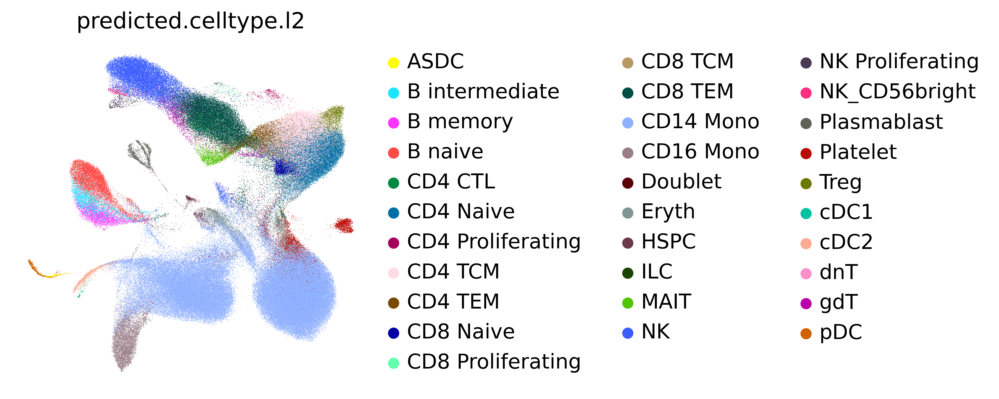

In [34]:
sc.pl.umap(adata_latent, color=cell_type_key)

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


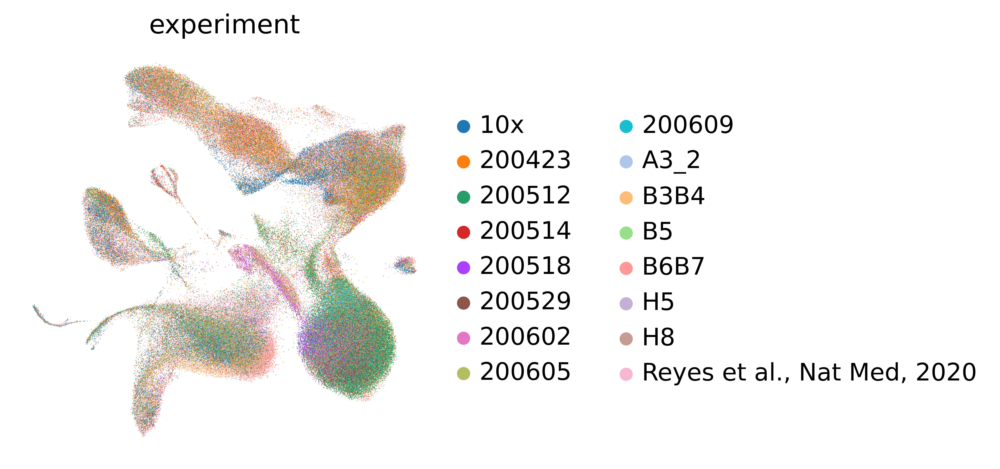

In [35]:
sc.pl.umap(adata_latent, color='experiment')

In [49]:
adata_latent.write('adata_latent_hierarchical_schulte.h5ad')

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


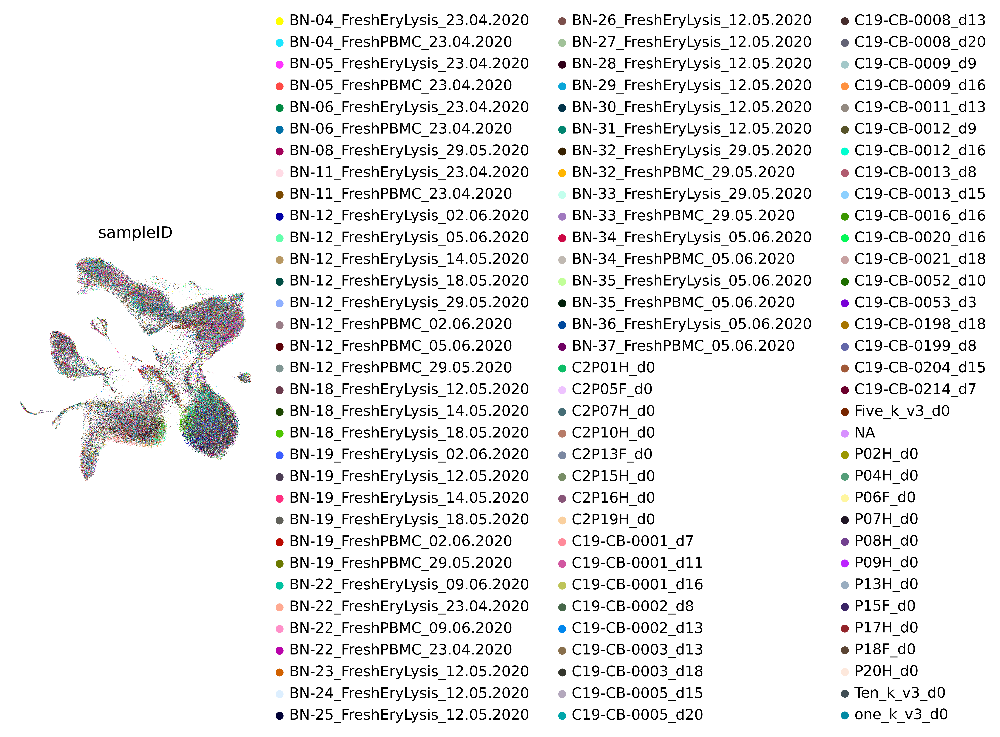

In [50]:
sc.pl.umap(adata_latent, color='sampleID')

In [46]:
scpoli_model.save('schulte_hierarchical_exp_sample_final', overwrite=True)

In [77]:
from sklearn.linear_model import LinearRegression
import scipy 
def pc_regression(
    emb_pca, covariate, pca_var=None, components=[0, 1],
):
    # fit linear model for n_comps PCs
    covariate = pd.get_dummies(covariate)
    r2 = []
    for i in components:
        pc = emb_pca[:, [i]]
        lm = LinearRegression()
        lm.fit(covariate, pc)
        r2_score = lm.score(covariate, pc)
        #r2_score, _ = scipy.stats.pearsonr(covariate, pc)
        r2.append(r2_score**2)

    Var = pca_var[components] / sum(pca_var[components]) * 100
    R2Var = sum(r2 * Var) / 100

    return R2Var

def embedding_plot_adata(
    adata, 
    condition_key,
    components,
    palette=None,
    title=None,
    bound=0.65,
    legendtitle=None,
    study_filename=None,
):
    cond = (
        adata
        .obs[condition_key]
    )
    #r2var = pc_regression(emb_pca, cond, pca.explained_variance_, components)
    #print(r2var)
    #fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    import seaborn as sns
    plt.rcParams['figure.figsize'] = (3, 3)
    emb_pca = adata.obsm['X_pca']
    pgrid = sns.jointplot(
        x=emb_pca[:, components[0]], 
        y=emb_pca[:, components[1]], 
        hue=cond,
        height=4,
        #hue_order = cond_to_keep,
        palette = palette,
        #ax=ax
        marginal_kws={'common_norm': True, 'clip': [-bound, bound]},
    )
    #for i in range(emb_pca.shape[0]):
    #    ax.text(
    #        x=emb_pca[i, components[0]]+0.01,
    #        y=emb_pca[i, components[1]]+0.01,
    #        s=patient_id[i],
    #        fontsize=5
    #    )
    #pgrid.ax_joint.text(0.4, 0.7, f'$R^{2} Var: {r2var:.2f}$', fontsize=12)
    pgrid.ax_joint.grid(False)
    pgrid.ax_marg_x.grid(False)
    pgrid.ax_marg_y.grid(False)
    pgrid.ax_marg_x.set_title(title, fontsize=25)
    pgrid.ax_joint.set_xlabel(f'PC{components[0]+1}', fontweight='bold', fontsize=12)
    pgrid.ax_joint.set_ylabel(f'PC{components[1]+1}', fontweight='bold', fontsize=12)
    pgrid.ax_joint.legend(title=legendtitle,bbox_to_anchor=(1.25, 1), loc=2, fontsize=12, frameon=False, borderaxespad=0., title_fontsize=22)
    sns.despine()
    #fig = pgrid.get_figure()
    #pgrid.savefig(f'suschulte/{study_filename}_sample_embeddings_{condition_key}_{components[0]}.png', dpi=500, bbox_inches='tight')

In [93]:
adata_emb = sc.read('schulte_final_sample_embedding.h5ad')

In [94]:
adata_emb.obs['experiment'] = adata_emb.obs['experiment'].astype(str)
adata_emb.obs['experiment'][adata_emb.obs['experiment'].str.contains("Reyes")] = 'Reyes et al.'
adata_emb.obs['experiment'] = adata_emb.obs['experiment'].astype('category')

/tmp/ipykernel_412069/1486256380.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_emb.obs['experiment'][adata_emb.obs['experiment'].str.contains("Reyes")] = 'Reyes et al.'


In [95]:
sc.pp.pca(adata_emb)

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

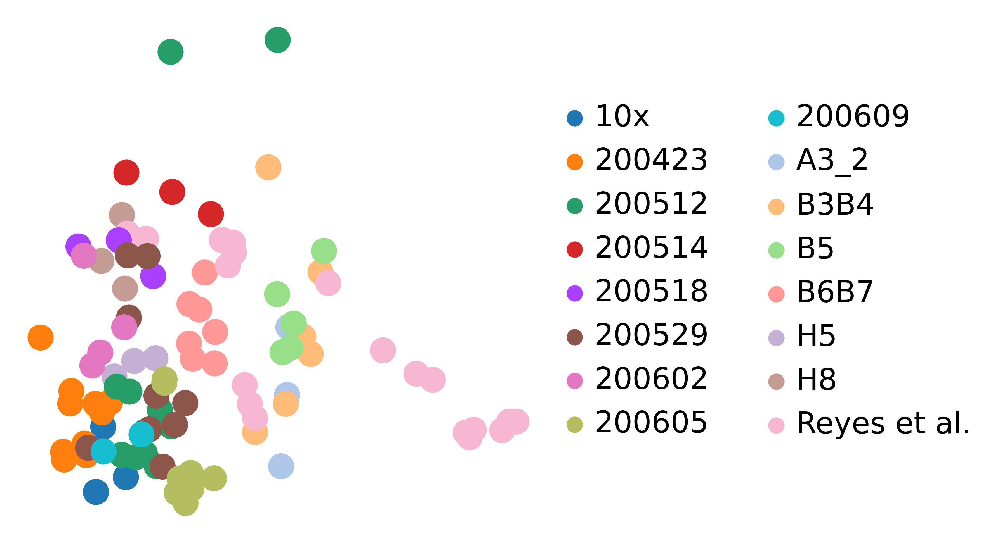

In [96]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.pca(adata_emb, color='experiment', size=500, frameon=False, show=False, ax=ax)
ax.set_title('')

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

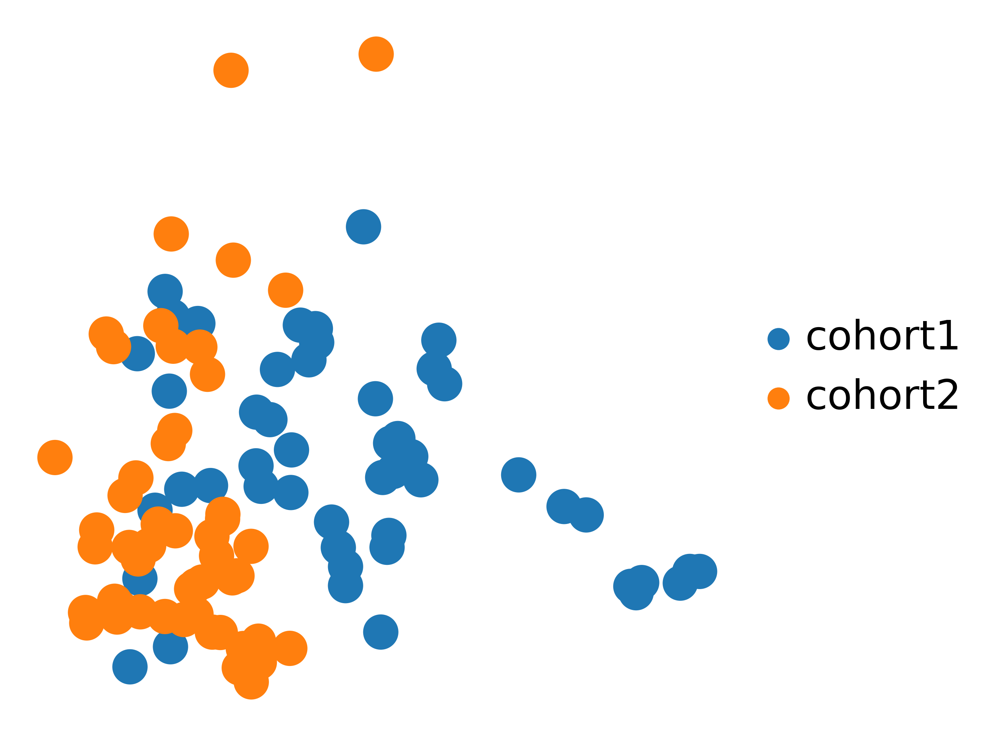

In [86]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.pca(adata_emb_sample, color='cohort', size=500, frameon=False, show=False, ax=ax)
ax.set_title('')

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

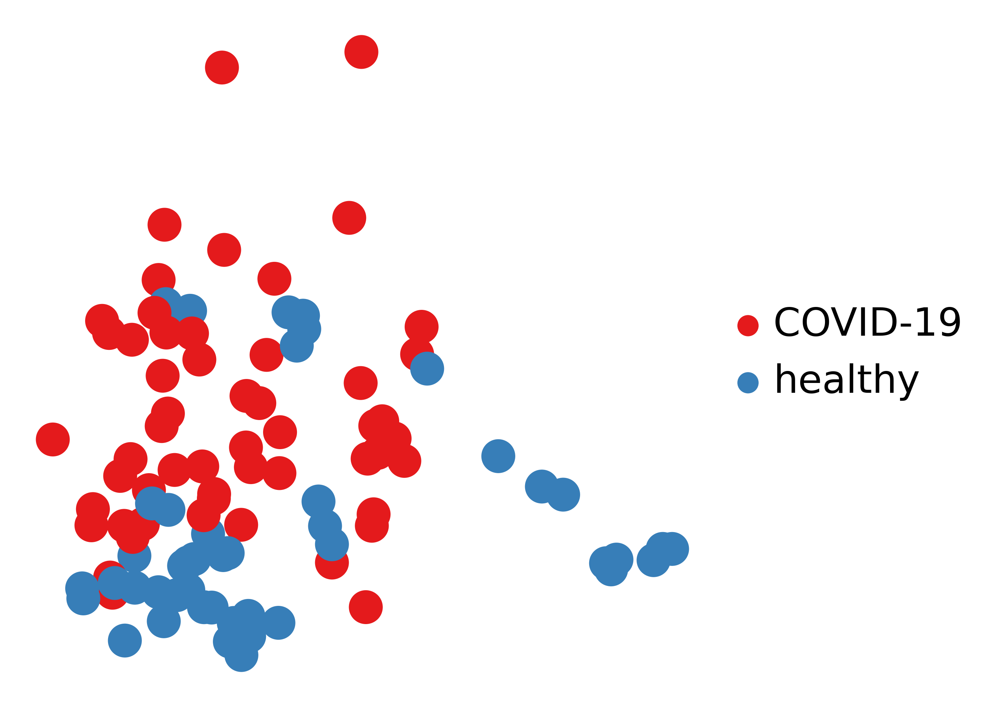

In [97]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.pca(adata_emb, color='disease_status', size=500, palette=sns.color_palette('Set1')[:2], frameon=False, show=False, ax=ax)
ax.set_title('')

In [98]:
adata_emb = sc.read('schulte_final_experiment_embedding.h5ad')
adata_emb.obs['experiment'] = adata_emb.obs['experiment'].astype(str)
adata_emb.obs['experiment'][adata_emb.obs['experiment'].str.contains("Reyes")] = 'Reyes et al.'
adata_emb.obs['experiment'] = adata_emb.obs['experiment'].astype('category')
sc.pp.pca(adata_emb)

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/tmp/ipykernel_412069/3461408226.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_emb.obs['experiment'][adata_emb.obs['experiment'].str.contains("Reyes")] = 'Reyes et al.'


/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

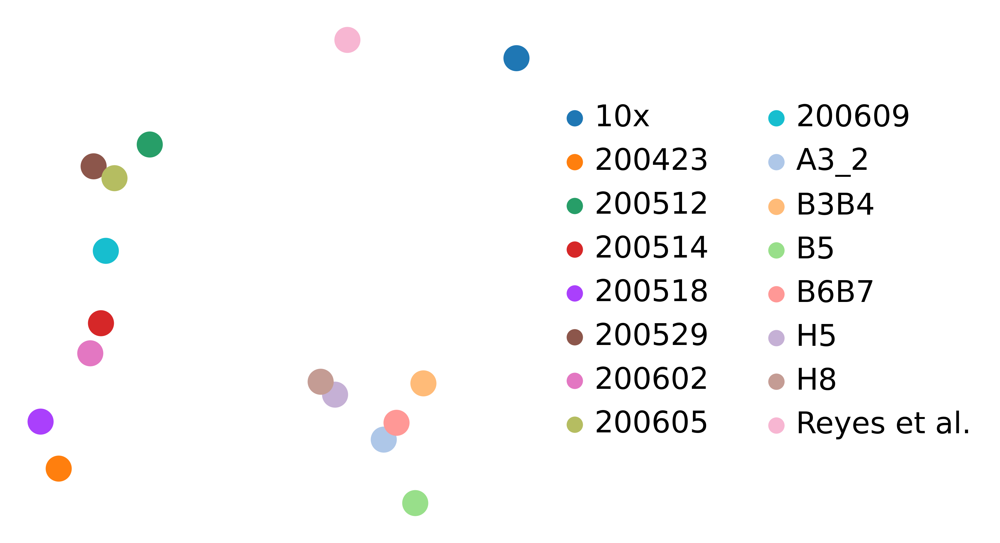

In [99]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.pca(adata_emb, color='experiment', size=500, frameon=False, show=False, ax=ax)
ax.set_title('')

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

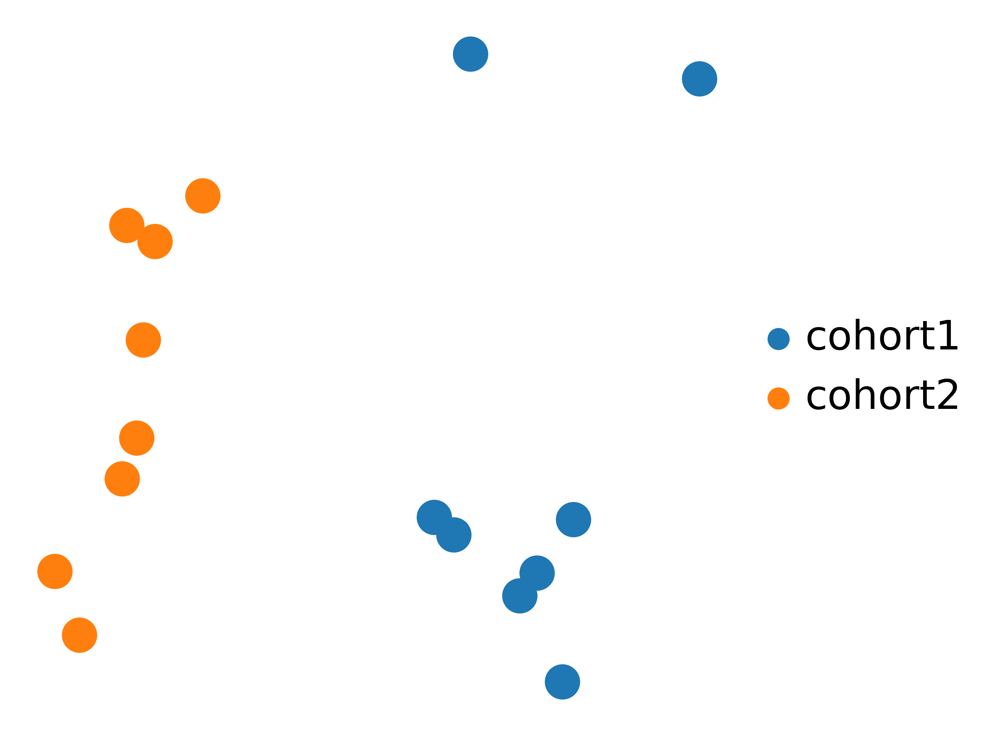

In [102]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.pca(adata_emb, color='cohort', size=500, frameon=False, show=False, ax=ax)
ax.set_title('')

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

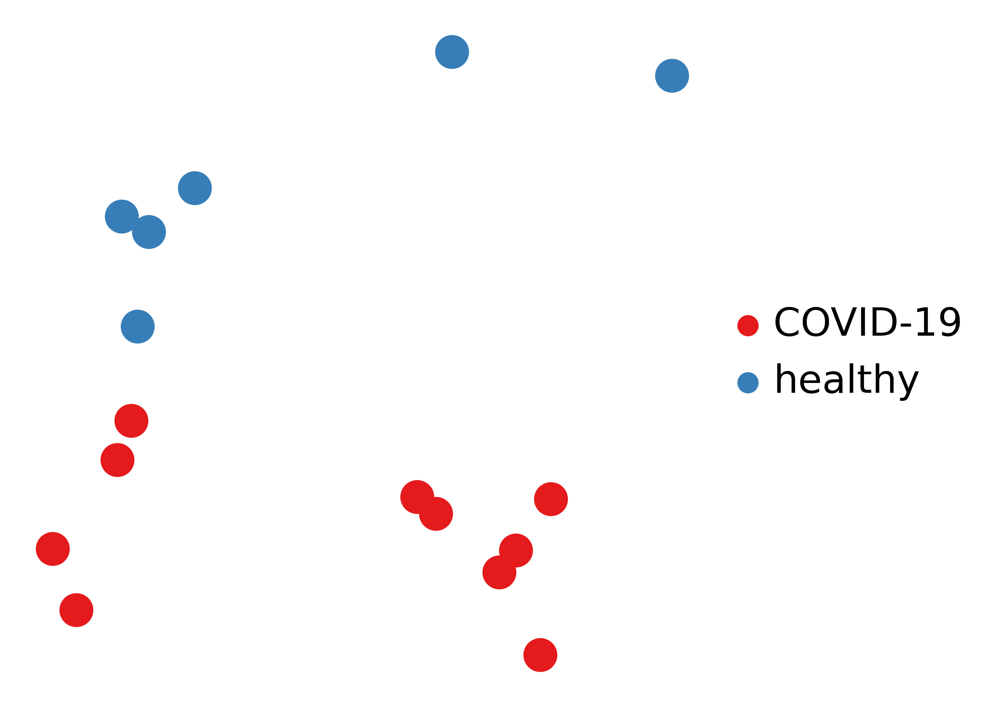

In [101]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.pca(adata_emb, color='disease_status', size=500, palette=sns.color_palette('Set1')[:2], frameon=False, show=False, ax=ax)
ax.set_title('')

In [107]:
adata_latent.obs['experiment'] = adata_latent.obs['experiment'].astype(str)
adata_latent.obs['experiment'][adata_latent.obs['experiment'].str.contains("Reyes")] = 'Reyes et al.'
adata_latent.obs['experiment'] = adata_latent.obs['experiment'].astype('category')

/tmp/ipykernel_412069/3609825502.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_latent.obs['experiment'][adata_latent.obs['experiment'].str.contains("Reyes")] = 'Reyes et al.'


/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

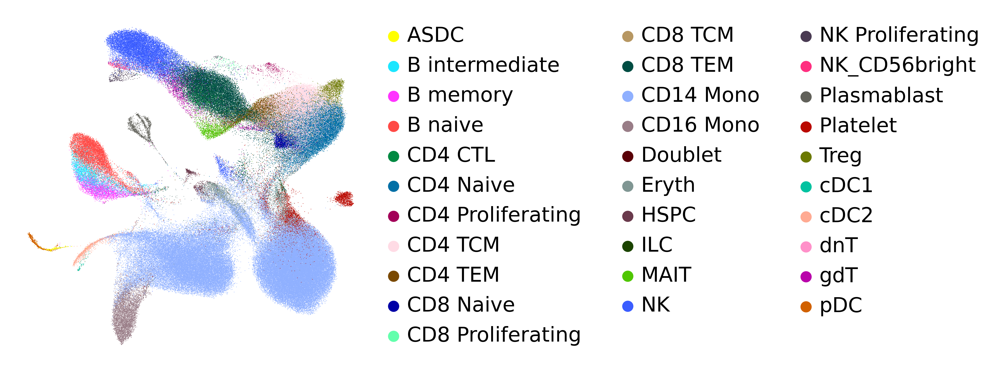

In [104]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_latent, color='predicted.celltype.l2',frameon=False, show=False, ax=ax)
ax.set_title('')

/home/icb/carlo.dedonno/anaconda3/envs/scarches/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Text(0.5, 1.0, '')

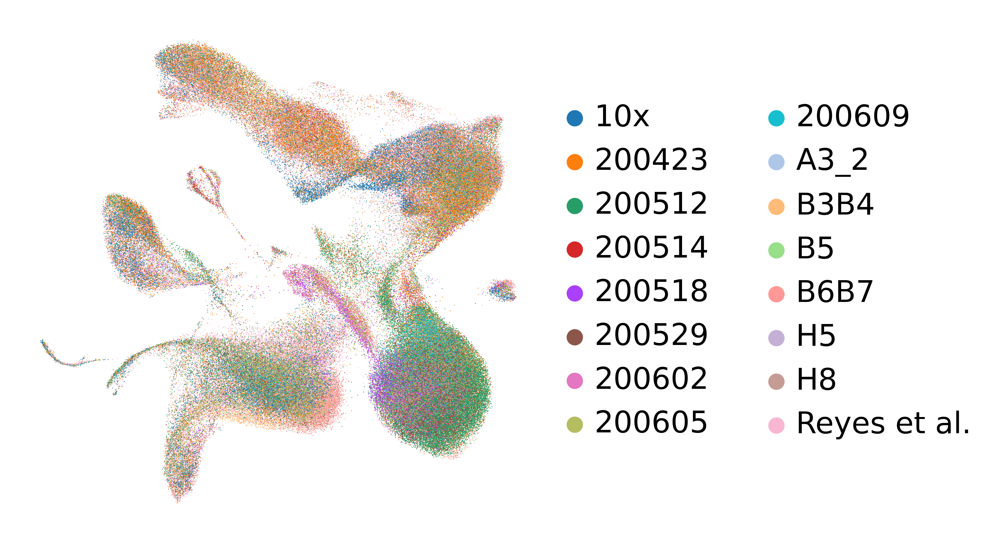

In [108]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_latent, color='experiment',frameon=False, show=False, ax=ax)
ax.set_title('')